In [1]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.animation as animation

import numpy as np

import h5py
import re
import datetime

import suite2p

from skimage.transform import resize
from skimage import draw
from skimage.segmentation import find_boundaries

from sklearn.cluster import KMeans

from scipy.signal import find_peaks
from scipy.interpolate import CubicSpline
from scipy.interpolate import UnivariateSpline
import scipy.interpolate

import util.info


plt.style.use(['dark_background'])

In [2]:
raw = ["C:\\Users\\zfj\\data\\100522B\\region1_00001.tif","C:\\Users\\zfj\\data\\100522B\\region1_00002.tif"]
timing = "C:\\Users\\zfj\\data\\100522B\\100522B.h5"
mask = "C:\\Users\\zfj\\data\\100522B\\region1_masks.tif"

# bing = ["C:\\Users\\zfj\\data\\100522B\\region1_00001\\reg.bin","C:\\Users\\zfj\\data\\100522B\\region1_00002\\reg.bin"]
# binr = ["C:\\Users\\zfj\\data\\100522B\\region1_00001\\reg_chan2.bin","C:\\Users\\zfj\\data\\100522B\\region1_00002\\reg_chan2.bin"]


bing = ["C:\\Users\\zfj\\data\\100522B\\region1_00001\\suite2p\\plane0\\data.bin","C:\\Users\\zfj\\data\\100522B\\region1_00002\\suite2p\\plane0\\data.bin"]
binr = ["C:\\Users\\zfj\\data\\100522B\\region1_00001\\suite2p\\plane0\\data_chan2.bin","C:\\Users\\zfj\\data\\100522B\\region1_00002\\suite2p\\plane0\\data_chan2.bin"]


In [3]:
## Get the trial metadata from the symphony file

symphony_file = h5py.File(timing,"r")
epoch_groups = []

dotNetOffset = 1e6*60*60 #ticks per hour
def append_epochs(name, g):
    if 'protocolID' in g.attrs and g.attrs['protocolID'] == b'sa_labs.protocols.stage.SpotGridAndChirp': 
        epochs = {
            'start_times':[],
            'trial_type':[],
            'cx':[],
            'cy':[],
        }   
        for epoch in g['epochs']:
            epochs['start_times'].append(g['epochs'][epoch].attrs['startTimeDotNetDateTimeOffsetTicks'])
            epochs['trial_type'].append(g['epochs'][epoch]['protocolParameters'].attrs['trialType'])
            if epochs['trial_type'][-1] == b'grid':
                epochs['cx'].append(g['epochs'][epoch]['protocolParameters'].attrs['cx'])
                epochs['cy'].append(g['epochs'][epoch]['protocolParameters'].attrs['cy'])
            else:
                epochs['cx'].append(np.array([]))
                epochs['cy'].append(np.array([]))
            
        epoch_groups.append({**g['protocolParameters'].attrs, 'epochs':epochs})
symphony_file.visititems(append_epochs)

In [4]:
epochs = {
    'start_times': [x for eg in epoch_groups for x in eg['epochs']['start_times']],
    'trial_type': [x for eg in epoch_groups for x in eg['epochs']['trial_type']],
    'cx': [x for eg in epoch_groups for x in eg['epochs']['cx']],
    'cy': [x for eg in epoch_groups for x in eg['epochs']['cy']],
}
#should filter / iterate on matching epoch blocks ....

In [5]:
## Read the scanimage file(s) for timestamps, sample rate, and raw data

ts = np.array([])
vid_len = []
for rawfile in raw:
    tif = suite2p.io.tiff.ScanImageTiffReader(rawfile)
    dotnet_epoch = datetime.datetime(1, 1, 1)
    us = datetime.timedelta(microseconds = 1)

    a = re.search("epoch = \[((?:\d+.?\d+,?)+)\]", tif.description(0))
    t = [float(x) for x in a.groups()[0].split(',')]
    t.append(t[-1] % 1 * 1e6)
    t = [int(ti) for ti in t]
    offset = 10 * (datetime.datetime(*t) - dotnet_epoch) // us 

    _ts = np.empty(len(tif)//4, dtype=np.int64)

    for i in np.arange(0, len(tif), 4):
        a = re.search("frameTimestamps_sec = (\d+.?\d+)", tif.description(i))
        _ts[i//4] = float(a.groups()[0]) * 1e7 + offset
    ts = np.insert(ts,len(ts),_ts)

    vid_len.append(len(tif)//4)

rawdat = np.concatenate([suite2p.io.tiff.ScanImageTiffReader(rawfile).data() for rawfile in raw], axis=0).reshape(-1,4,32,128)
a = re.search("SI.hRoiManager.scanFrameRate = (\d+.?\d+)", tif.metadata())
fr = float(a.groups()[0])
sf =  fr * tif.data().shape[1] * tif.data().shape[2]

In [7]:
## Learn the trigger levels and noise using k-means clustering on the trigger channel

trig = rawdat[:,3,:,:]
trig[:,1::2,:] = np.flip(trig[:,1::2,:], axis=2) #bidi scanning
trig = trig.reshape(-1,1)

# If we don't include the start trigger, we will probably not learn it.
# Find the top 25 spikes in the trigger channel. These are likely start triggers
trig_candidates = np.argpartition(trig[2:] - trig[:-2],-25, axis=0)[-25:].flatten()

# Train the classifier using windows around the putative start triggers
km = KMeans(n_clusters=5, algorithm='elkan').fit(trig[trig_candidates[:,None] + np.arange(-1000,50000)].reshape(-1,1)) #~7s
fl = km.predict(trig)

# Reorder the predictions in ascending voltage order
idx = np.argsort(km.cluster_centers_.flatten())
lut = np.zeros_like(idx)
lut[idx] = np.arange(len(idx))
fl = lut[fl]


In [8]:
## Calculate the frame number from the trigger labels

flips = np.where(np.diff(fl))[0]
flips = np.insert(flips,(0,-1),(0,len(fl)-1))


fi = np.empty_like(fl, dtype=float)
fi[:flips[1]] = np.nan

rm = []
last_flip = 0
for i in range(1,len(flips)):
    if (flips[i] - flips[i-1] < sf/140):
        rm.append(i)
        continue
    elif fl[flips[i]] == 4:
        fi[last_flip:flips[i]] = 3 # the first 4 frames have an identical signature, should be preTime
    elif fl[flips[i]] == 0:
        fi[last_flip:flips[i]] = ((fi[last_flip-1] + 4)//4)*4
    elif fl[flips[i]] == 3:
        fi[last_flip:flips[i]] = ((fi[last_flip-1] + 3)//4)*4 + 1
    elif fl[flips[i]] == 1:
        fi[last_flip:flips[i]] = ((fi[last_flip-1] + 2)//4)*4 + 2
    elif fl[flips[i]] == 2:
        fi[last_flip:flips[i]] = ((fi[last_flip-1] + 1)//4)*4 + 3
    
    last_flip = flips[i]
fi[-1] = fi[-2]
flips = np.delete(flips, rm)

(-1.0, 25.0)

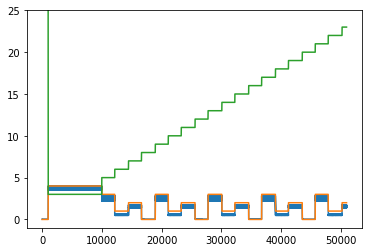

In [9]:
plt.plot(trig[trig_candidates[1,None] + np.arange(-1000,50000)] / trig.max() * (km.n_clusters-1))
plt.plot(fl[trig_candidates[1,None] + np.arange(-1000,50000)])
plt.plot(fi[trig_candidates[1,None] + np.arange(-1000,50000)])
plt.ylim(-1, 25)

59 28


(-9.0, 9.0)

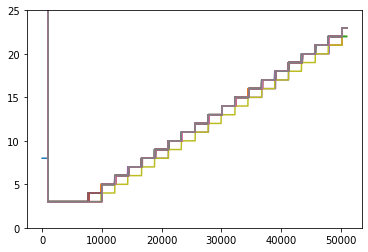

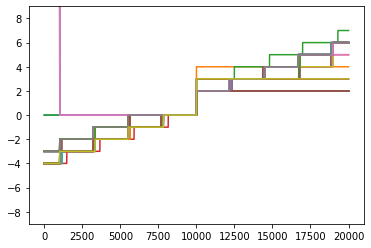

In [10]:
## Find dropped frames and trial start times

dropped = np.where(np.diff(fi)>1)[0]
trial = np.where(np.diff(fi)<0)[0]
print(len(dropped), len(trial))

plt.plot(fi[trial[:,None] + np.arange(-1000,50000)].squeeze().T)
plt.ylim(0,25)

plt.figure()
plt.plot((fi[dropped[:,None] + np.arange(-10000,10000)] - fi[dropped[:,None]]).squeeze().T)
plt.ylim(-9,9)


In [11]:
## Align trials between symphony and scanimage

time_delta = np.abs(np.expand_dims(epochs['start_times'],axis=0) - np.expand_dims(ts[trial//(32*128)],axis=1))
idx_e = time_delta.argmin(axis=0)
idx_i = time_delta.argmin(axis=1)


idx_i_missing = np.where(np.take_along_axis(time_delta, np.expand_dims(idx_i, axis=1), axis=1) > 1e7)[1]
idx_i = np.delete(idx_i, idx_i_missing)

idx_e_missing = np.where(np.take_along_axis(time_delta, np.expand_dims(idx_e, axis=0), axis=0) > 1e7)[1]
idx_e = np.delete(idx_e, idx_e_missing)
idx_e_idx = idx_e.argsort()

for k in epochs:
    epochs[k] = np.delete(epochs[k], idx_e_missing)
    epochs[k] = epochs[k][idx_e_idx] #sort the trials by start time

trial= np.delete(trial, idx_i_missing)

c:\Users\zfj\anaconda3\envs\suite2p\lib\site-packages\numpy\lib\function_base.py:5030: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = asarray(arr)


In [120]:
spots = {'cx': [], 'spot_on': [], 'spot_off':[], 'pre_on':[], 'tail_off':[]}
for i, (tt, xs, tr) in enumerate(zip(epochs['trial_type'], epochs['cx'], trial)):
    if tt==b'grid':
        #get the index of the trial start in the frame toggle array
        flip_i =np.where(flips==tr+1)[0][0]
        pre_i = 0
        on_i = 15
        off_i = 30
        # tail_i = 90
        j = 0
        while (i < len(trial)-1 and flips[flip_i + off_i] < trial[i+1]) or (i == len(trial)-1 and flip_i + off_i < len(flips)):
            #the current index will be the beginning of the 'preTime'
            spots['pre_on'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=pre_i)])

            #find the index where the spot goes on (15 frames) and off (30 frames)
            spots['spot_on'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=on_i)])
            spots['spot_off'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=off_i)])

            spots['cx'].append(xs[j])
        
            #the next trial starts 90 frames later...
            j+=1
            pre_i += 90
            on_i += 90
            off_i += 90

            spots['tail_off'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=pre_i)])


print(len(spots['spot_on']), len(spots['spot_off']), len(spots['pre_on']), len(spots['tail_off']))
print(spots['pre_on'][0], spots['spot_on'][0], spots['spot_off'][0], spots['tail_off'][0])
print(spots['pre_on'][0] - spots['pre_on'][0], spots['spot_on'][0] - spots['pre_on'][0], spots['spot_off'][0] - spots['pre_on'][0], spots['tail_off'][0] - spots['pre_on'][0])

436 436 436 436
19420415 19451848 19485311 19619711
0 31433 64896 199296


In [473]:
chirps = {'pre_on':[], 'chirp_on':[],'chirp_off':[], 'tail_off':[]}
for i, (tt, tr) in enumerate(zip(epochs['trial_type'], trial)):
    if tt==b'chirp':
        #get the index of the trial start in the frame toggle array
        flip_i =np.where(flips==tr+1)[0][0]
        on_i = 60*2
        off_i = 60*30
        # tail_i = 90
        
        chirps['pre_on'].append(flips[flip_i])

        chirps['chirp_on'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=(60*2))])
        chirps['chirp_off'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=(60*30))])
    
        chirps['tail_off'].append(flips[flip_i + np.argmax(fi[flips[flip_i:]]>=(60*35))])

print(len(chirps['chirp_on']), len(chirps['chirp_off']), len(chirps['pre_on']), len(chirps['tail_off']))


8 8 8 8


TiffPage 0: TypeError: read_bytes() missing 3 required positional arguments: 'dtype', 'count', and 'offsetsize'


[16135, 23916]
(436, 48, 176)


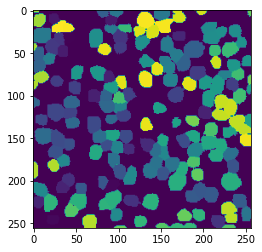

In [91]:
m = suite2p.io.tiff.open_tiff(mask, True)[0].pages[0].asarray()
frame_i = (np.expand_dims(np.array(spots['spot_on'])//(32*128),axis=0) + np.expand_dims(np.arange(-8,40),axis=1)).T

def segment_ds(paths):
    # data = suite2p.io.BinaryRWFile(32, 128, path).data[(frame_i).flatten()]
    data = np.concatenate([suite2p.io.BinaryRWFile(32, 128, path).data for path in paths], axis=0)[(frame_i).flatten()]
    um = np.unique(m)
    act = np.empty((len(data),len(um)-1))

    for i in range(1, len(um)):
        m_i = resize((m==um[i]).astype(np.float64), (32,128), anti_aliasing=True)
        m_i /= m_i.sum()
        m_i = m_i.reshape((1,32,128)).repeat(len(data), 0)

        act[:,i-1] = (m_i * data).mean(axis=(1,2))
    
    return act.reshape((*frame_i.shape, -1))

print(vid_len)
g = segment_ds(bing)
print(g.shape)
# gr = g / segment_ds(binr)

plt.imshow(m)

TiffPage 0: TypeError: read_bytes() missing 3 required positional arguments: 'dtype', 'count', and 'offsetsize'


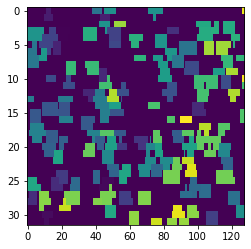

In [222]:
# plt.imshow(rawdat[:,0,:,:].mean(axis=0), aspect=4)
# meanr = resize(rawdat[:,0,:,:].mean(axis=0),(256,256))
# plt.imshow(np.stack((meanr/meanr.max() * 2, (m>0)/2, np.zeros_like(m)), axis=2))

# meanr = resize(suite2p.io.BinaryRWFile(32, 128, binr[0]).data.mean(axis=0), (256,256))
# plt.imshow(np.stack((meanr/meanr.max(), (m>0)/5, np.zeros_like(m)), axis=2))

# print(suite2p.io.BinaryRWFile(32, 128, binr[0]).shape)
m = suite2p.io.tiff.open_tiff(mask, True)[0].pages[0].asarray()

plt.figure()
mm = np.array([(resize((m==i).astype(np.float64), (32,128), anti_aliasing=True) > .5)*i for i in range(176)]).max(axis=0)

plt.imshow(mm, aspect=4, interpolation='nearest')


False


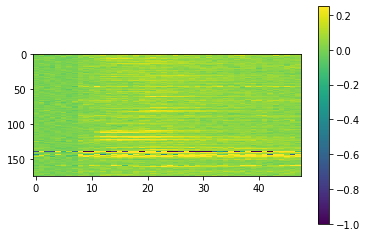

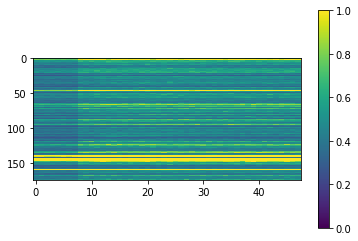

In [324]:
# frame_i = (np.expand_dims(np.array(spots['spot_on'])//(32*128),axis=0) + np.expand_dims(np.arange(-8,40),axis=1)).T
# print(frame_i[np.array(spots['spot_on'])//(32*128) < vid_len[0], :].shape)
# print(frame_i[np.array(spots['spot_on'])//(32*128) >= vid_len[0], :].shape)
dFoF = (g - g[:,:8,:].mean(axis=1, keepdims=True)) / g[:,:8,:].mean(axis=1, keepdims=True)
plt.imshow(dFoF.mean(axis=0).T, aspect=1/8, interpolation='nearest')
plt.clim(-1,.25)
plt.colorbar()

plt.figure()

plt.imshow(dFoF.std(axis=0).T, aspect=1/8, interpolation='nearest')
plt.clim(0,1)
plt.colorbar()

print(np.isnan(dFoF).any())

In [94]:
ue, e_i, e_c = np.unique(spots['cx'], return_inverse=True, return_counts=True)
# print(e_i)

(436, 48, 176)


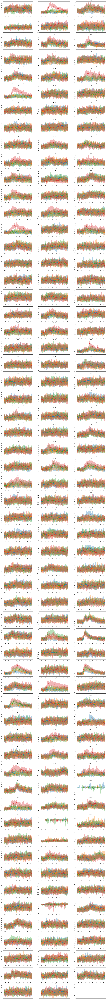

In [332]:
_,axs = plt.subplots(59,3,figsize=(30,59*5))
axs = axs.flatten()
print(dFoF.shape)
# axs[0].plot(np.array([dFoF[e_i==i,:,120].mean(axis=0) for i in range(len(ue))]).T)
# axs[0].errorbar(np.array([np.linspace(-.25,1.25,48) for i in range(len(ue))]).T,np.array([dFoF[e_i==i,:,120].mean(axis=0) for i in range(len(ue))]).T, np.array([dFoF[e_i==i,:,120].std(axis=0) for i in range(len(ue))]).T)
# i=0
# cs = [120, 80, 12]
for ci in range(176):
    for i in range(len(ue)):
        # axs[c].errorbar(np.linspace(-.25,1.25,48),dFoF[e_i==i,:,c].mean(axis=0), dFoF[e_i==i,:,c].std(axis=0) / np.sqrt(e_c[i]))
        line = axs[ci].plot(np.linspace(-.25,1.25,48),dFoF[e_i==i,:,ci].mean(axis=0))[0]
        
        c = line.get_color()
        axs[ci].fill_between(
            np.linspace(-.25,1.25,48),
            dFoF[e_i==i,:,ci].mean(axis=0) - 3*dFoF[e_i==i,:,ci].std(axis=0) / np.sqrt(e_c[i]),
            dFoF[e_i==i,:,ci].mean(axis=0) + 3*dFoF[e_i==i,:,ci].std(axis=0) / np.sqrt(e_c[i]),
            facecolor = c,
            alpha = 0.33
        )
        
        axs[ci].set_title(f'ROI {ci}')


c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:33: RuntimeWarning: divide by zero encountered in log2
  HR = -np.nansum(self.Py * np.log2(self.Py))
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:33: RuntimeWarning: invalid value encountered in multiply
  HR = -np.nansum(self.Py * np.log2(self.Py))
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:34: RuntimeWarning: divide by zero encountered in log2
  HRS = -np.nansum(self.Py_x * np.log2(self.Py_x) * self.stim_prob)
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:34: RuntimeWarning: invalid value encountered in multiply
  HRS = -np.nansum(self.Py_x * np.log2(self.Py_x) * self.stim_prob)
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:50: RuntimeWarning: divide by zero encountered in log2
  HRS_ind = -np.nansum(Py_x_ind * np.log2(Py_x_ind) * self.stim_prob)
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:50: RuntimeWarning: invalid value enc

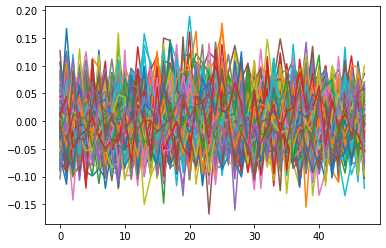

In [96]:
model = util.info.MI(e_i, 1, 12)
MI = np.array([[model.QE(dFoF[:,t,c, None], nreps=3, samps=np.arange(200,436,6), shuffle=False) for t in range(48)] for c in range(176)])

plt.plot(MI.T)

In [54]:
model = util.info.MI(e_i, 1, 12)

MI = np.array([[model.QE(dFoF[:,t,c, None], nreps=3, samps=np.arange(200,436,6), shuffle=False) for t in range(48)] for c in range(176)])

c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:33: RuntimeWarning: divide by zero encountered in log2
  HR = -np.nansum(self.Py * np.log2(self.Py))
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:33: RuntimeWarning: invalid value encountered in multiply
  HR = -np.nansum(self.Py * np.log2(self.Py))
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:34: RuntimeWarning: divide by zero encountered in log2
  HRS = -np.nansum(self.Py_x * np.log2(self.Py_x) * self.stim_prob)
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:34: RuntimeWarning: invalid value encountered in multiply
  HRS = -np.nansum(self.Py_x * np.log2(self.Py_x) * self.stim_prob)
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:50: RuntimeWarning: divide by zero encountered in log2
  HRS_ind = -np.nansum(Py_x_ind * np.log2(Py_x_ind) * self.stim_prob)
c:\Users\zfj\code\functionalimaginganalysis\python\util\info.py:50: RuntimeWarning: invalid value enc

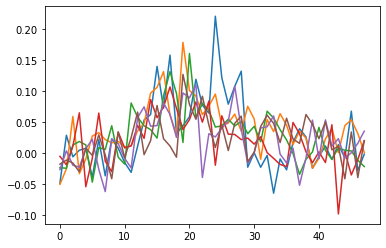

In [108]:
# plt.plot(MI.mean(axis=0))
cs = [1, 15, 39, 112, 121, 141]
# plt.plot(MI[cs,:].T)
for c in cs:
    plt.plot([model.QE(dFoF[:,t,c, None], shuffle=False) for t in range(48)])

# MI.shape

In [338]:
import util.gpr
import importlib
importlib.reload(util.gpr)

dfs = util.gpr.preprocess(
    np.concatenate([suite2p.io.BinaryRWFile(32, 128, path).data for path in bing], axis=0),
    (1/fr, 1/1085.0, 1/1085.0*.9/128),
    np.array((spots['pre_on'], spots['spot_on'], spots['spot_off'], spots['tail_off'])),
    e_i,
    mm
)

# fr
# np.save('100522B_region1_stim_timing.npy', (spots['pre_on'], spots['spot_on'], spots['spot_off'], spots['tail_off']))
# np.save('100522B_region1_stim_i.npy', e_i)
# np.save('100522B_region1_masks_ds.npy', mm)


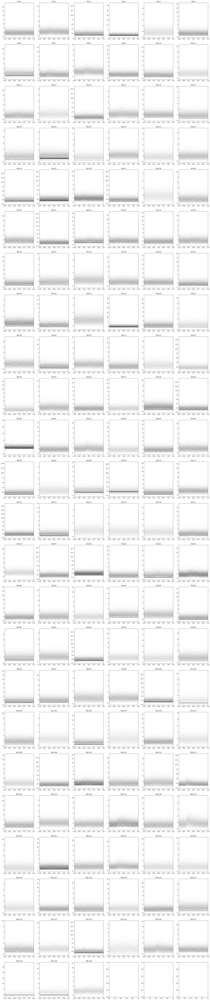

In [339]:
_, axs = plt.subplots(24,6,figsize=(30,150))
axs = axs.flatten()
for ci in range(len(dfs)):
    axs[ci].scatter(dfs[ci]['trial_t'], dfs[ci]['y'], s=0.5, c='w', alpha=.03)
    axs[ci].set_xlim(-.25,1.25)
    axs[ci].set_title(f'ROI {ci}')
    # plt.hist(dfs[ci]['trial_t'])
    # print(dfs[ci])

In [239]:
# 119
import GPy
# x = dfs[119]['trial_t']
# y = dfs[119]['y']
ci = 8
# mod = []
ps = []
xn = np.linspace(-.25,1.25)[:,None]
for ci in range(len(dfs)):
    p = []
    for i in range(4):
        df_i = dfs[ci][dfs[ci]['stimulus']==i] 
        x = df_i['trial_t'][:,None]
        y = df_i['y'][:,None]

        m1 = GPy.models.SparseGPRegression(
            x,
            y,
            num_inducing=300,
            kernel = GPy.kern.RBF(1),
        )
        
        m1.optimize_restarts(4, messages=False, max_iters = 20)

        mu1,sig1 = m1.predict(xn, include_likelihood = False)
        _,sigO1 = m1.predict(xn, include_likelihood = True)
        
        # mod.append(m1)
        p.append((mu1,sig1,sigO1))

        # plt.plot(xn, mu1)
    ps.append(p)

np.save('100522B_region1_gpr.npy',ps)


 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\635101305.py:13: FutureWarning:Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\635101305.py:14: FutureWarning:Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.


Optimization restart 1/4, f = 19214.544393262157
Optimization restart 2/4, f = 19215.080528683586
Optimization restart 3/4, f = 19215.077023542708
Optimization restart 4/4, f = 19215.088290280317
Optimization restart 1/4, f = 15504.892973867325
Optimization restart 2/4, f = 15504.955857056102
Optimization restart 3/4, f = 15504.880273736775
Optimization restart 4/4, f = 15505.65753974538
Optimization restart 1/4, f = 15040.71591274563
Optimization restart 2/4, f = 15040.709001168005
Optimization restart 3/4, f = 15040.963810957172
Optimization restart 4/4, f = 15040.709767504213
Optimization restart 1/4, f = 14387.139080687106
Optimization restart 2/4, f = 14388.245231393006
Optimization restart 3/4, f = 14387.046504250588
Optimization restart 4/4, f = 14389.115833375447
Optimization restart 1/4, f = 18401.93467732782
Optimization restart 2/4, f = 18422.139585668
Optimization restart 3/4, f = 18422.128212769152
Optimization restart 4/4, f = 18422.16462855746
Optimization restart 1/4, f

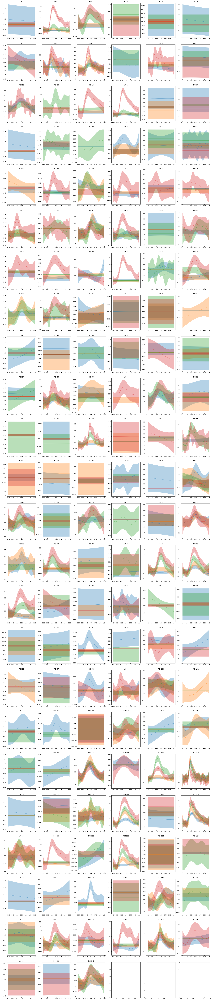

In [269]:

_, axs = plt.subplots(24,6,figsize=(30,150))
axs = axs.flatten()
for ci in range(len(dfs)):
    # axs[ci].scatter(dfs[ci]['trial_t'], dfs[ci]['y'], s=0.5, c='k', alpha=.03)
    # axs[ci].set_xlim(-.25,1.25)
    # axs[ci].set_title(f'ROI {ci}')
    # # plt.hist(dfs[ci]['trial_t'])
    # # print(dfs[ci])
    p = ps[ci]
    for i in range(4):
        line, = axs[ci].plot(xn,p[i][0], linewidth=0.5)
        c = line.get_color()
        axs[ci].fill_between(
            xn.flatten(),
            (p[i][0] + 3*np.sqrt(p[i][1])).flatten(),
            (p[i][0] - 3*np.sqrt(p[i][1])).flatten(),
            facecolor = c,
            alpha = 0.33
        )
        axs[ci].set_title(f'ROI {ci}')

        # plt.gca().fill_between(
        #     xn.flatten(),
        #     (p[i][0] + 3*np.sqrt(p[i][2])).flatten(),
        #     (p[i][0] - 3*np.sqrt(p[i][2])).flatten(),
        #     facecolor = c,
        #     alpha = 0.10
        # )
    
# plt.plot(p[0][2])

[[  0   0   0   0   0   0  78  78  78  78  78  78  78  78  78  78]
 [  0   0   0   0   0   0   0  78  78  78  78  78  78  78  78  78]
 [  0   0   0   0   0   0   0  78  78  78  78  78  78  78  78  78]
 [  0   0   0   0   0   0   0   0  78  78  78  78  78  78  78  78]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0  78]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0 134 134 134 134 134   0   0   0  53]
 [  0   0   0   0   0 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0   0 134 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0 134 134 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0 134 134 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0 134 134 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0 134 134 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0 134 134 134 134 134 134 134 134 134 134 134 134 134]
 [  0   0   0 134 134 134 134 134 134 134 134 134 134 134 134 

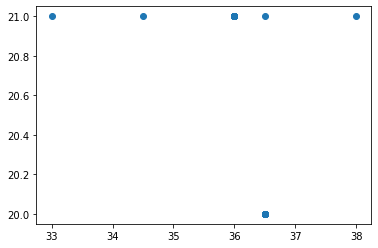

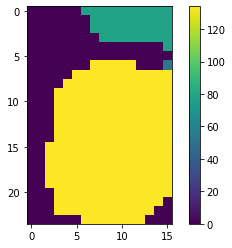

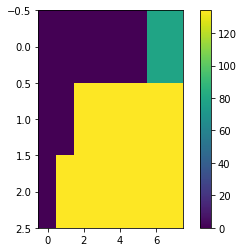

In [330]:
plt.scatter(dfs[112]['x'], dfs[112]['line'])
plt.figure()
plt.imshow(m[19*8:22*8, 2*32:2*40])
plt.colorbar()
print(m[19*8:22*8, 2*32:2*40])
plt.figure()
plt.imshow(mm[19:22, 32:40], aspect=4, interpolation='nearest')
plt.colorbar()

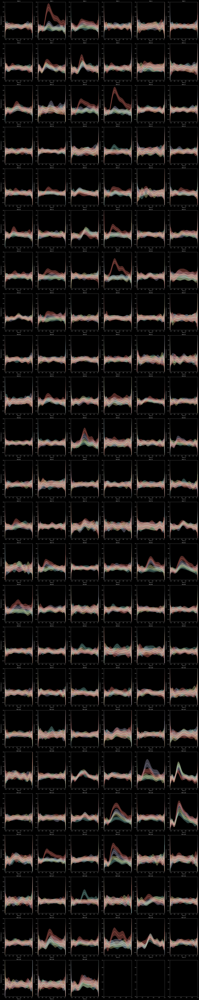

In [471]:
# dff = dfs[112].groupby(['frame', 'trial', 'luminance','stimulus']).mean().reset_index()
# dff['f_baseline'] = dff['y']

# spline = CubicSpline
# spline = lambda x,y: UnivariateSpline(x,y, k=5, s = 15)
spline = lambda x,y: np.poly1d(np.polyfit(x,y,12))

# for i in range(5):
#     dff_i = dff[dff['trial']==i]
#     s = plt.scatter(dff_i['trial_t'], dff_i['y'], s = 20)
#     print(s)

#     plt.draw()

#     cs = spline(dff_i['trial_t'], dff_i['y'])
#     plt.plot(xn, cs(xn), color=s.get_facecolors()[0])
# plt.scatter(dff['trial_t'], dff['y'], s = .5, c='k', alpha=.5)

# plt.xlim(-.25,1.25)
# plt.ylim(-2,4)

_, axs = plt.subplots(24,6,figsize=(30,150))
axs = axs.flatten()
for ci in range(len(dfs)):
    dff = dfs[ci].groupby(['frame', 'trial', 'luminance','stimulus']).mean().reset_index()
    for i in range(4):
        dff_i = dff[dff['stimulus']==i]
        # s = plt.scatter(dff_i['trial_t'], dff_i['y'], s = .5, alpha=.2)
        # plt.draw()

        u,u_i = np.unique(dff_i['trial'], return_inverse=True)
        di_int = np.empty((len(u), len(xn)))
        # print(u_i)
        # for j,j_i in zip(u.astype(int),u_i):
        for j in range(len(u)):
            t = dff_i[u_i==j].sort_values('trial_t')
            # print(j,j_i)
            # print(dff_i[u_i==j])
            cs = spline(t['trial_t'], t['y'])
            di_int[j,:] = cs(xn).squeeze()
        # plt.plot(xn,np.nanmean(di_int,axis=0), c=s.get_facecolors()[0], alpha=1)
        
        
        line = axs[ci].plot(xn,np.nanmean(di_int,axis=0), alpha=1)[0]
        c = line.get_color()
        axs[ci].fill_between(
            xn.flatten(),
            (np.nanmean(di_int,axis=0) + 3*np.nanstd(di_int,axis=0)/np.sqrt(len(u))).flatten(),
            (np.nanmean(di_int,axis=0) - 3*np.nanstd(di_int,axis=0)/np.sqrt(len(u))).flatten(),
            facecolor = c,
            alpha = 0.33
        )
    axs[ci].set_xlabel('Time (s)')
    axs[ci].set_ylabel('Fluorescence (a.u.)')
    axs[ci].set_xlim(-.25, 1.25)
    axs[ci].set_ylim(-.5,1.0)
    axs[ci].set_title(f'ROI {ci}')

    plt.tight_layout()



 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\3910794078.py:42: RankWarning:Polyfit may be po

(-2.0, 5.0)

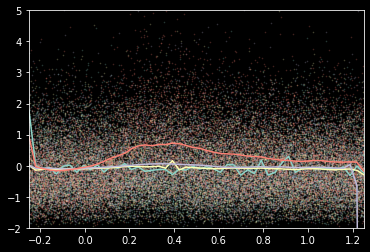

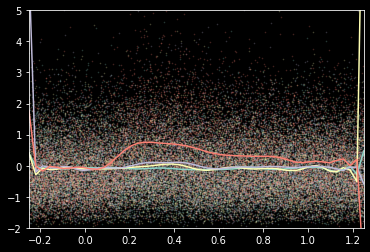

In [470]:
ci=1
# dff = dfs[ci].groupby(['frame', 'trial', 'luminance','stimulus']).mean().reset_index()
# print(dff)
dff = dfs[ci].reset_index()

# spline = CubicSpline
spline = lambda x,y: UnivariateSpline(x,y, k=5, s = 105)
for i in range(4):
    dff_i = dff[dff['stimulus']==i]
    s = plt.scatter(dff_i['trial_t'], dff_i['y'], s = .5, alpha=.2)
    plt.draw()

    u,u_i = np.unique(dff_i['trial'], return_inverse=True)
    di_int = np.empty((len(u), len(xn)))
    for j in range(len(u)):
        t = dff_i[u_i==j].sort_values('trial_t')
        cs = spline(t['trial_t'], t['y'])
        di_int[j,:] = cs(xn).squeeze()
    
    
    c = s.get_facecolors()[0]

    plt.plot(xn,np.nanmean(di_int,axis=0), alpha=1, color=c)
plt.xlim(-.25, 1.25)
plt.ylim(-2,5)

plt.figure()

# spline = CubicSpline
# spline = scipy.interpolate.Akima1DInterpolator
# spline = lambda x,y: UnivariateSpline(x,y, k=5, s = 15)
spline = lambda x,y: np.poly1d(np.polyfit(x,y,25))
for i in range(4):
    dff_i = dff[dff['stimulus']==i]
    s = plt.scatter(dff_i['trial_t'], dff_i['y'], s = .5, alpha=.2)
    plt.draw()

    u,u_i = np.unique(dff_i['trial'], return_inverse=True)
    di_int = np.empty((len(u), len(xn)))
    for j in range(len(u)):
        t = dff_i[u_i==j].sort_values('trial_t')
        cs = spline(t['trial_t'], t['y'])
        di_int[j,:] = cs(xn).squeeze()
    
    
    c = s.get_facecolors()[0]

    plt.plot(xn,np.nanmean(di_int,axis=0), alpha=1, color=c)
plt.xlim(-.25, 1.25)
plt.ylim(-2,5)

 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\2542280752.py:16: RankWarning:Polyfit may be po

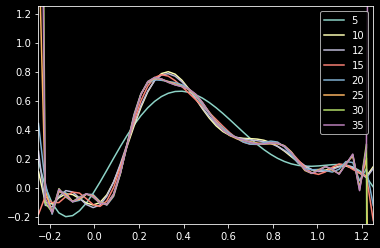

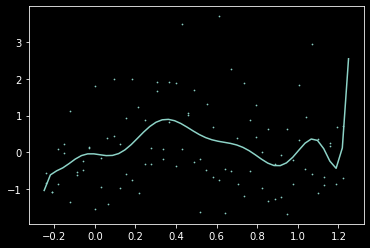

In [469]:
dff = dfs[1]

plt.figure()
for k in [5, 10, 12, 15, 20, 25, 30, 35]:
    spline = lambda x,y: np.poly1d(np.polyfit(x,y,k))
    for i in [3]:
        dff_i = dff[dff['stimulus']==i]
        # s = plt.scatter(dff_i['trial_t'], dff_i['y'], s = .5, alpha=.2)
        # plt.draw()

        u,u_i = np.unique(dff_i['trial'], return_inverse=True)
        # print(u)
        di_int = np.empty((len(u), len(xn)))
        for j in range(len(u)):
            t = dff_i[u_i==j].sort_values('trial_t')
            cs = spline(t['trial_t'], t['y'])
            di_int[j,:] = cs(xn).squeeze()

        plt.plot(xn,np.nanmean(di_int,axis=0), alpha=1)
plt.xlim(-.25, 1.25)
plt.ylim(-.25,1.25)
plt.legend([5, 10, 12, 15, 20, 25, 30, 35])

plt.figure()
dff_i = dff[dff['trial']==10]
s = plt.scatter(dff_i['trial_t'], dff_i['y'], s = .5, alpha=1)
plt.plot(xn, np.poly1d(np.polyfit(dff_i['trial_t'], dff_i['y'], 12))(xn))

(-0.25, 1.25)

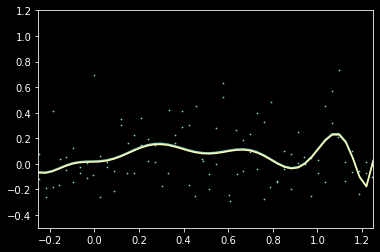

In [468]:
# print(dff['y'].min())
dff = dfs[112]
all_min = min([df['y'].min() for df in dfs])
di = dff.copy().reset_index().set_index('trial')
di['y'] = di['y'] - all_min
di['baseline_y'] = di.groupby(['trial']).apply(lambda x: x[x['trial_t']<0]['y'].mean())
di['dFoF'] = di.apply(lambda x: (x['y'] - x['baseline_y'])/x['baseline_y'], axis=1)
di = di.reset_index()

plt.figure()
dff_i = di[di['trial']==10]
s = plt.scatter(dff_i['trial_t'], dff_i['dFoF'], s = .5, alpha=1)
plt.plot(xn, np.poly1d(np.polyfit(dff_i['trial_t'], dff_i['dFoF'], 12))(xn))

dff_i = dff[dff['trial']==10]
yest = np.poly1d(np.polyfit(dff_i['trial_t'], dff_i['y'], 12))(xn) - all_min
# y_baseline = yest[xn<0].mean()
y_baseline = np.median(yest[np.logical_and(xn<0, xn>-.2)])
yest = (yest - y_baseline) / y_baseline
plt.plot(xn, yest)
plt.ylim(-.5,1.2)
plt.xlim(-.25,1.25)

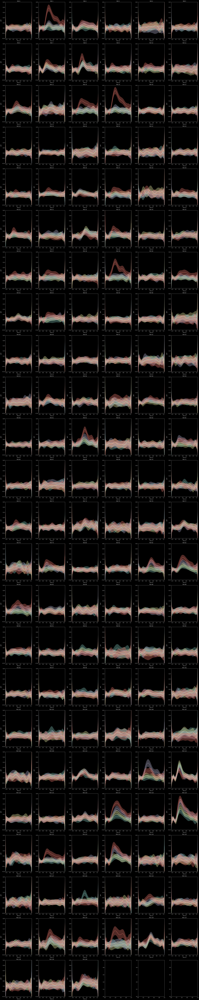

In [466]:
spline = lambda x,y: np.poly1d(np.polyfit(x,y,12))


_, axs = plt.subplots(24,6,figsize=(30,150))
axs = axs.flatten()
for ci in range(len(dfs)):
    # dff = dfs[ci].groupby(['frame', 'trial', 'luminance','stimulus']).mean().reset_index()
    dff = dfs[ci].copy().set_index('trial')
    dff['y'] = dff['y'] - all_min
    dff['baseline_y'] = dff.groupby(['trial']).apply(lambda x: x[x['trial_t']<0]['y'].mean())
    dff['dFoF'] = dff.apply(lambda x: (x['y'] - x['baseline_y'])/x['baseline_y'], axis=1)
    dff = dff.reset_index()

    for i in range(4):
        dff_i = dff[dff['stimulus']==i]
        u,u_i = np.unique(dff_i['trial'], return_inverse=True)
        di_int = np.empty((len(u), len(xn)))
        for j in range(len(u)):
            t = dff_i[u_i==j].sort_values('trial_t')
            cs = spline(t['trial_t'], t['dFoF'])
            di_int[j,:] = cs(xn).squeeze()
        
        
        line = axs[ci].plot(xn,np.nanmean(di_int,axis=0), alpha=1)[0]
        c = line.get_color()
        axs[ci].fill_between(
            xn.flatten(),
            (np.nanmean(di_int,axis=0) + 3*np.nanstd(di_int,axis=0)/np.sqrt(len(u))).flatten(),
            (np.nanmean(di_int,axis=0) - 3*np.nanstd(di_int,axis=0)/np.sqrt(len(u))).flatten(),
            facecolor = c,
            alpha = 0.33
        )
    axs[ci].set_xlabel('Time (s)')
    axs[ci].set_ylabel('ΔF/F')
    axs[ci].set_xlim(-.25, 1.25)
    axs[ci].set_ylim(-.1,0.25)
    axs[ci].set_title(f'ROI {ci}')
plt.tight_layout()

In [475]:

dfs_chirp = util.gpr.preprocess(
    np.concatenate([suite2p.io.BinaryRWFile(32, 128, path).data for path in bing], axis=0),
    (1/fr, 1/1085.0, 1/1085.0*.9/128),
    np.array((chirps['pre_on'], chirps['chirp_on'], chirps['chirp_off'], chirps['tail_off'])),
    np.ones(len(chirps)),
    mm
)

In [542]:
# dfs_chirp[1]
ci = 113
xn_chirp = np.linspace(-2,33,500)[:,None]

x = dfs_chirp[ci]['trial_t'][:,None]
y = dfs_chirp[ci]['y'][:,None]

m1 = GPy.models.SparseGPRegression(
    x,
    y,
    num_inducing=300,
    kernel = GPy.kern.RBF(1),
)

m1.optimize_restarts(4, messages=False, max_iters = 20)

mu1,sig1 = m1.predict(xn_chirp, include_likelihood = False)
_,sigO1 = m1.predict(xn_chirp, include_likelihood = True)


 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\383198978.py:5: FutureWarning:Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\383198978.py:6: FutureWarning:Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.


Optimization restart 1/4, f = 12844.977892030105
Optimization restart 2/4, f = 13011.292102683841
Optimization restart 3/4, f = 12977.33712508097
Optimization restart 4/4, f = 13011.225355026168


In [496]:
def chirp(sf):
   return np.concatenate((
        np.zeros(2*sf), #pre time
        np.ones(3*sf), #positive step
        np.zeros(3*sf), #negative time
        np.ones(2*sf) * 0.5, #inter time
        
        -np.sin(2*np.pi*np.linspace(0,8/sf,sf*8).cumsum() + np.pi)/2 + .5, # freq chirp
        np.ones(2*sf) * 0.5, #inter time
        -np.linspace(0,1,sf*8)*np.sin(2*np.pi*2*np.linspace(1/sf, 8, sf*8) + np.pi)/2 + .5, # amp chirp

        np.ones(2*sf) * 0.5, #inter time
        np.zeros(5*sf), #tail time
   )) 

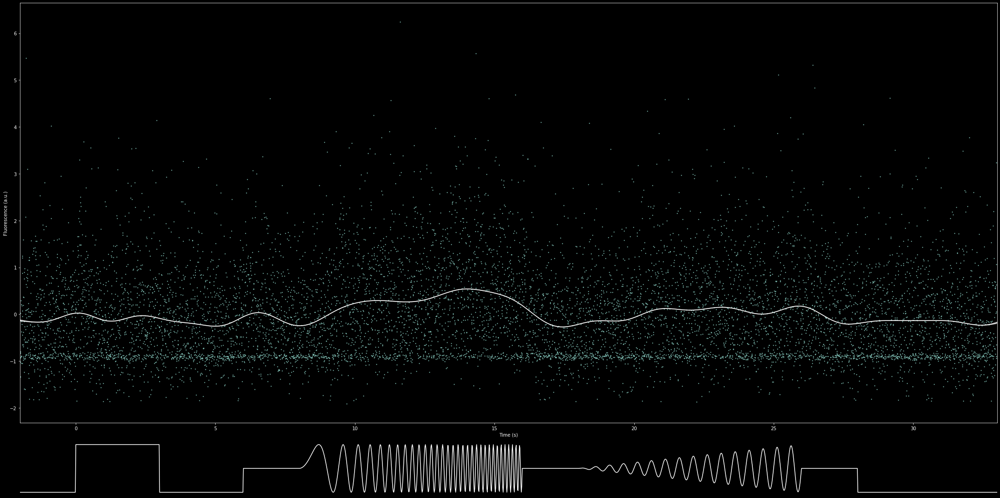

In [546]:
# ci=113
_,axs = plt.subplots(2,1,gridspec_kw={'height_ratios': [8, 1]}, figsize=(30,15))
# _,axs = plt.subplots(2,1,gridspec_kw={'height_ratios': [8, 1]}, figsize=(5,3))
axs[0].scatter(dfs_chirp[ci]['trial_t'], dfs_chirp[ci]['y'], s=1)
axs[0].plot(xn_chirp, mu1, color='w')
axs[0].set_xlim(-2,33)
axs[0].set_xlabel('Time (s)')
axs[0].set_ylabel('Fluorescence (a.u.)')
axs[0].fill_between(
    xn_chirp.flatten(),
    mu1.flatten() + 3*sig1.flatten(),
    mu1.flatten() - 3*sig1.flatten(),
    facecolor = 'w',
    alpha = .5
)
# axs[0].fill_between(
#     xn_chirp.flatten(),
#     mu1.flatten() + 3*sigO1.flatten(),
#     mu1.flatten() - 3*sigO1.flatten(),
#     facecolor = 'w',
#     alpha = .2
# )


axs[1].plot(np.linspace(-2,33,60*35), chirp(60), color='w')
axs[1].axis('off')
axs[1].set_xlim(-2,33)

plt.tight_layout()


[0. 1. 2. 3.]


 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\1057885177.py:12: UserWarning:Boolean Series key will be reindexed to match DataFrame index.
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\1057885177.py:13: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\1057885177.py:13: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\1057885177.py:13: RankWarning:Polyfit may be poorly conditioned
 C:\Users\zfj\AppData\Local\Temp\ipykernel_13088\1057885177.py:13: RankWarning:Polyfit may be poorly conditioned


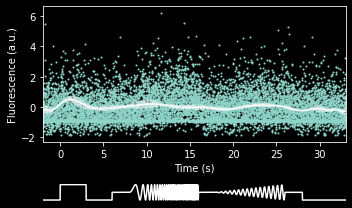

In [547]:
spline_chirp = lambda x,y: np.poly1d(np.polyfit(x,y,35))

# _,axs = plt.subplots(2,1,gridspec_kw={'height_ratios': [8, 1]}, figsize=(30,15))

_,axs = plt.subplots(2,1,gridspec_kw={'height_ratios': [8, 1]}, figsize=(5,3))
axs[0].scatter(dfs_chirp[ci]['trial_t'], dfs_chirp[ci]['y'], s=1)

ue = np.unique(dfs_chirp[ci]['trial'])
di_int = np.empty((len(ue), len(xn_chirp)))
print(ue)
for j in range(len(ue)):
    t = dfs_chirp[1][dfs_chirp[ci]['trial'] == ue[j]].sort_values('trial_t')
    cs = spline_chirp(t['trial_t'], t['y'])
    di_int[j,:] = cs(xn_chirp).squeeze()

axs[0].plot(xn_chirp, di_int.mean(axis=0), color='w')
axs[0].fill_between(
    xn_chirp.flatten(),
    di_int.mean(axis=0) + 3*di_int.std(axis=0)/np.sqrt(len(ue)),
    di_int.mean(axis=0) - 3*di_int.std(axis=0)/np.sqrt(len(ue)),
    facecolor = 'w',
    alpha = .5
)


axs[0].set_xlim(-2,33)
axs[0].set_xlabel('Time (s)')
axs[0].set_ylabel('Fluorescence (a.u.)')

axs[1].plot(np.linspace(-2,33,60*35), chirp(60), color='w')
axs[1].axis('off')
axs[1].set_xlim(-2,33)

plt.tight_layout()


(20, 20, 50, 32, 128)
(50, 32, 128)


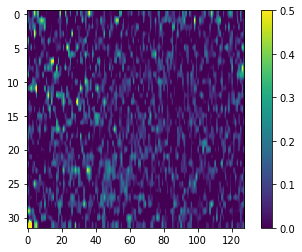

In [746]:
ue, e_i, e_c = np.unique(np.stack((epochs['cx'][0],epochs['cy'][0])),axis=1, return_inverse=True, return_counts=True)
# print(list(zip(epochs['cx'][0], epochs['cy'][0])),e_i, e_c)
# print(e_i.shape, ue.shape)

edat = np.empty((20, 20, 50, 32, 128)) * np.nan

#some hot garbage...
i = 0
for tt, tr in zip(epochs['trial_type'], trial):
    if tt==b'grid':
        flip_i =np.where(flips==tr+1)[0][0]
        flip0 = flips[flip_i]
        j = 0
        flip_i+=1
        while j<20: #fi[flips[flip_i]] < 2100:
            while flip_i < len(flips)-1 and fi[flips[flip_i]] > fi[flip0] and fi[flips[flip_i]] < (90 * (j+1)):                
                flip_i+=1
            flipf = flips[flip_i]
            f0 = flip0//(32*128)
            ff = flipf//(32*128)

            
            # print(j, ff - f0, fi[flips[flip_i]])

            edat[i,j,:ff-f0] = rawdat[f0:ff,1,:,:]


            j+=1
            flip0 = flipf
            flip_i+=1
        i += 1


print(edat.shape)
# edat = (edat - edat[:,:,:8].mean(axis=2, keepdims=True)) / edat[:,:,:8].mean(axis=2, keepdims=True)
# edat[np.isinf(edat)] = np.nan

edat = np.nanmean(edat, axis=(0,1))

edat = (edat - edat[:8].mean(axis=0, keepdims=True)) / edat[:8].mean(axis=0, keepdims=True)
edat[np.isinf(edat)] = np.nan

print(edat.shape)
plt.imshow(edat[30], aspect=4)
plt.clim(0,.5)
plt.colorbar()

# edat = np.array([rawdat[tr:tr+int(fr*35),1,:,:] for tt, tr in zip(epochs['trial_type'], trial//(32*128)) if tt==b'chirp'])
# gdat = (edat - edat[:,:100,:,:].mean(axis=1, keepdims=True)) / edat[:,:100,:,:].mean(axis=1, keepdims=True)
# gdat[np.isinf(gdat)] = np.nan
# gdat = np.nanmean(gdat, axis=0)
# edat = edat.mean(axis=0)
# print(edat.shape, gdat.shape)
# # im = plt.imshow(gdat[501], extent=105.3*np.array([-1,1,-1,1]), cmap=LinearSegmentedColormap.from_list("Green", [(0,0,0), (0,1,0)]))
# im = plt.imshow(edat[501], extent=105.3*np.array([-1,1,-1,1]), cmap=LinearSegmentedColormap.from_list("Green", [(0,0,0), (0,1,0)]))
# plt.colorbar()

MovieWriter ffmpeg unavailable; using Pillow instead.


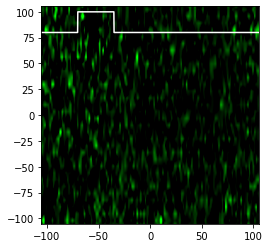

In [745]:
# %%capture

# gmax = edat.max()

fig = plt.figure()
ax = plt.gca()

z = np.zeros((256,256))

g_i = np.array([resize(edat[t],(256,256))  for t in range(len(edat))])

im = ax.imshow(g_i[0], extent=105.3*np.array([-1,1,-1,1]), cmap=LinearSegmentedColormap.from_list("Green", [(0,0,0), (0,1,0)]))
im.set_clim(0,1)
# im.set_clim(0,500)

ti = np.linspace(-105.3,105.3,2100)
# ch = 20*chirp(60)+80
ch = np.zeros(2100)
ch[350:700]=1
ch = 20*ch + 80

ind = np.linspace(0, len(ch)-1, len(g_i)).astype(int)

pl = plt.plot(ti[:ind[0]], ch[:ind[0]], color='white')

def anim(i):
    im.set_data(g_i[i])
    pl[0].set_data(ti[:ind[i]], ch[:ind[i]])
    return [im,pl[0]]

animation.FuncAnimation(fig, anim, frames=len(g_i), interval=20, blit=True).save('mean_response_allspots.gif', fps=fr)
